In [4]:
from google.colab import drive
!pip install ultralytics
import os
import cv2
from IPython.display import Image
import matplotlib.pyplot as plt
from PIL import Image
from ultralytics import YOLO

In [ ]:
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
def count_files_in_folder(folder_path):
    if not os.path.isdir(folder_path):
        print(f"The given path '{folder_path}' is not a directory.")
        return 0  # Return 0 to handle invalid directories gracefully.
    files = os.listdir(folder_path)
    num_files = len(files)
    return num_files

folder_path1 = "/content/drive/MyDrive/dataset/train_subset-20241223T111901Z-001/test/images"
folder_path2 = "/content/drive/MyDrive/dataset/train_subset-20241223T111901Z-001/valid/images"
folder_path3 = "/content/drive/MyDrive/dataset/train_subset-20241223T111901Z-001/train/images"

num_files1 = count_files_in_folder(folder_path1)
num_files2 = count_files_in_folder(folder_path2)
num_files3 = count_files_in_folder(folder_path3)

# Print results
print(f"Test set: {num_files1} files")
print(f"Validation set: {num_files2} files")
print(f"Train set: {num_files3} files")
print(f"Total dataset: {num_files1 + num_files2 + num_files3}")

Test set: 271 files
Validation set: 300 files
Train set: 326 files
Total dataset: 897


In [ ]:
model = YOLO("yolov8m.pt")

**Training**

In [ ]:
results = model.train(data='/content/drive/MyDrive/dataset/train_subset-20241223T111901Z-001/data.yaml',
                      epochs=150,batch=16,imgsz=640, plots=True)

Ultralytics 8.3.53 🚀 Python-3.10.12 torch-2.5.1+cu121 CPU (Intel Xeon 2.20GHz)
engine/trainer: task=detect, mode=train, model=yolov8m.pt, data=/content/drive/MyDrive/dataset/train_subset-20241223T111901Z-001/data.yaml, epochs=150, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False

100%|██████████| 755k/755k [00:00<00:00, 77.3MB/s]


Overriding model.yaml nc=80 with nc=2

                   from  n    params  module                                       arguments                     
  0                  -1  1      1392  ultralytics.nn.modules.conv.Conv             [3, 48, 3, 2]                 
  1                  -1  1     41664  ultralytics.nn.modules.conv.Conv             [48, 96, 3, 2]                
  2                  -1  2    111360  ultralytics.nn.modules.block.C2f             [96, 96, 2, True]             
  3                  -1  1    166272  ultralytics.nn.modules.conv.Conv             [96, 192, 3, 2]               
  4                  -1  4    813312  ultralytics.nn.modules.block.C2f             [192, 192, 4, True]           
  5                  -1  1    664320  ultralytics.nn.modules.conv.Conv             [192, 384, 3, 2]              
  6                  -1  4   3248640  ultralytics.nn.modules.block.C2f             [384, 384, 4, True]           
  7                  -1  1   1991808  ultralytics

train: Scanning /content/drive/MyDrive/dataset/train_subset-20241223T111901Z-001/train/labels... 326 images, 0 backgrounds, 0 corrupt: 100%|██████████| 326/326 [01:25<00:00,  3.82it/s]


train: New cache created: /content/drive/MyDrive/dataset/train_subset-20241223T111901Z-001/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


/usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 1.4.23 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
val: Scanning /content/drive/MyDrive/dataset/train_subset-20241223T111901Z-001/valid/labels... 300 images, 6 backgrounds, 0 corrupt: 100%|██████████| 300/300 [01:22<00:00,  3.64it/s]


val: New cache created: /content/drive/MyDrive/dataset/train_subset-20241223T111901Z-001/valid/labels.cache
Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 77 weight(decay=0.0), 84 weight(decay=0.0005), 83 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to runs/detect/train
Starting training for 150 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/21 [00:00<?, ?it/s]

In [ ]:
!cp -r "/content/runs" "/content/drive/MyDrive/parkingW"

**Testing (test set)**

In [ ]:
!yolo task=detect \
mode=val \
model="/content/runs/detect/train/weights/best.pt" \
data="/content/drive/MyDrive/dataset/train_subset-20241223T111901Z-001/data.yaml" split=test

In [ ]:
best_model_path = os.path.join('/content/runs/detect/train/weights/best.pt')
best_model = YOLO(best_model_path)
TestImage = Image.open(open("/content/drive/MyDrive/parking space.v2i.yolov8/test/images/2022-11-15-14-07-04_mp4-56_jpg.rf.35b2de967912e555c734fd2bf5b4987d.jpg", 'rb'))
TestImage = best_model(TestImage,classes=[0,1]) #, classes=[0]
# Display annotated image
plt.figure(figsize=(20,15))
plt.imshow(TestImage[0].plot(line_width=2))
plt.title('Detected Objects in Sample Image by the best YOLOv8 Model', fontsize=20)
plt.axis('off')
plt.show()

**Testing (vid)**


0: 384x640 40 space-emptys, 24 space-occupieds, 65.0ms
Speed: 4.3ms preprocess, 65.0ms inference, 601.1ms postprocess per image at shape (1, 3, 384, 640)


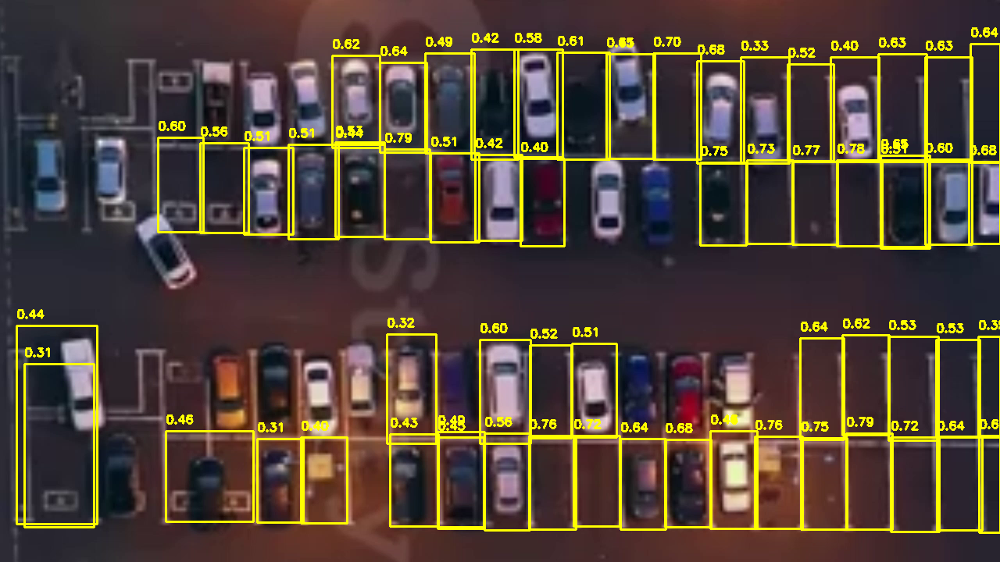


0: 384x640 41 space-emptys, 24 space-occupieds, 25.2ms
Speed: 2.3ms preprocess, 25.2ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


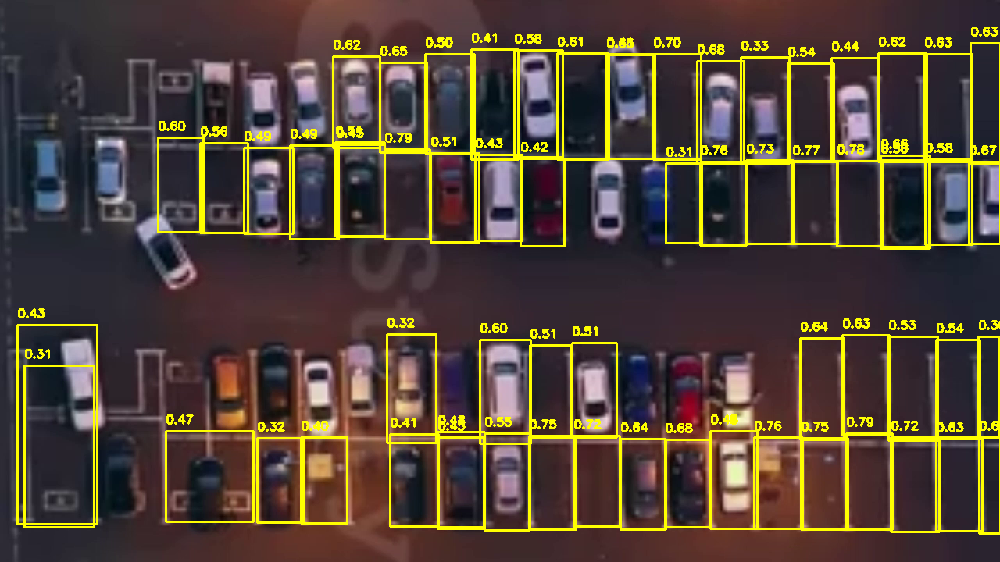


0: 384x640 41 space-emptys, 24 space-occupieds, 27.4ms
Speed: 2.2ms preprocess, 27.4ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


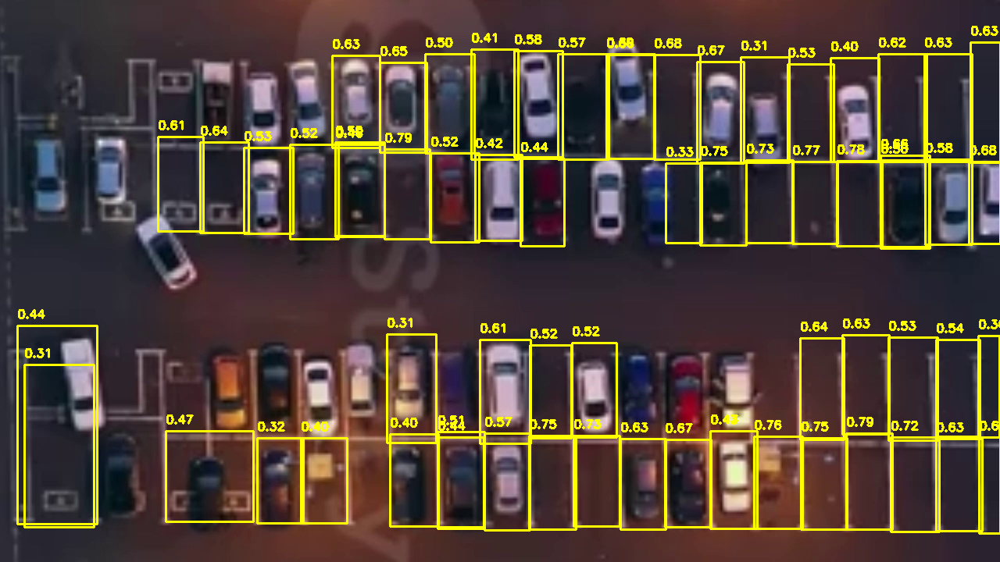


0: 384x640 40 space-emptys, 24 space-occupieds, 28.2ms
Speed: 2.2ms preprocess, 28.2ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)


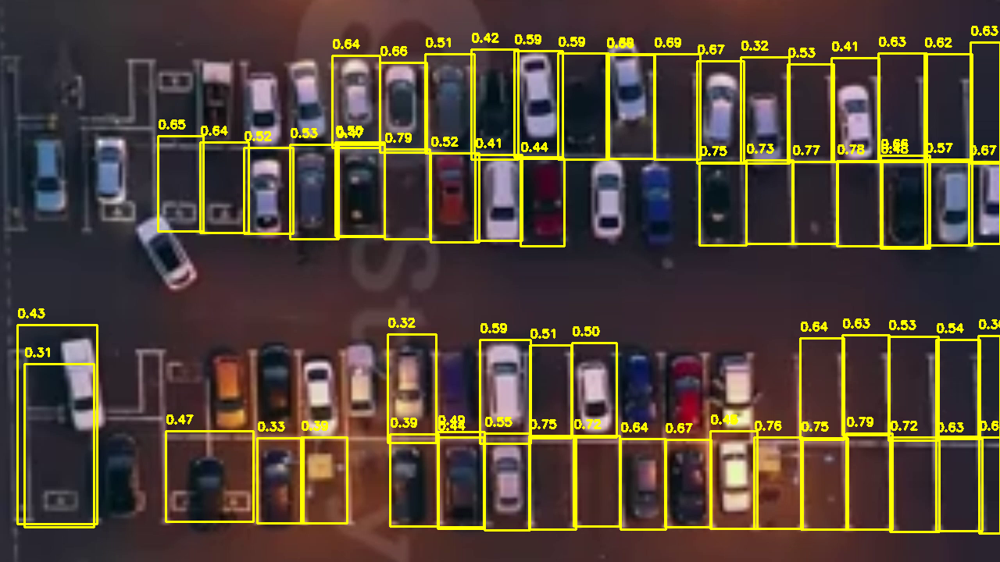


0: 384x640 40 space-emptys, 24 space-occupieds, 27.8ms
Speed: 2.2ms preprocess, 27.8ms inference, 3.4ms postprocess per image at shape (1, 3, 384, 640)


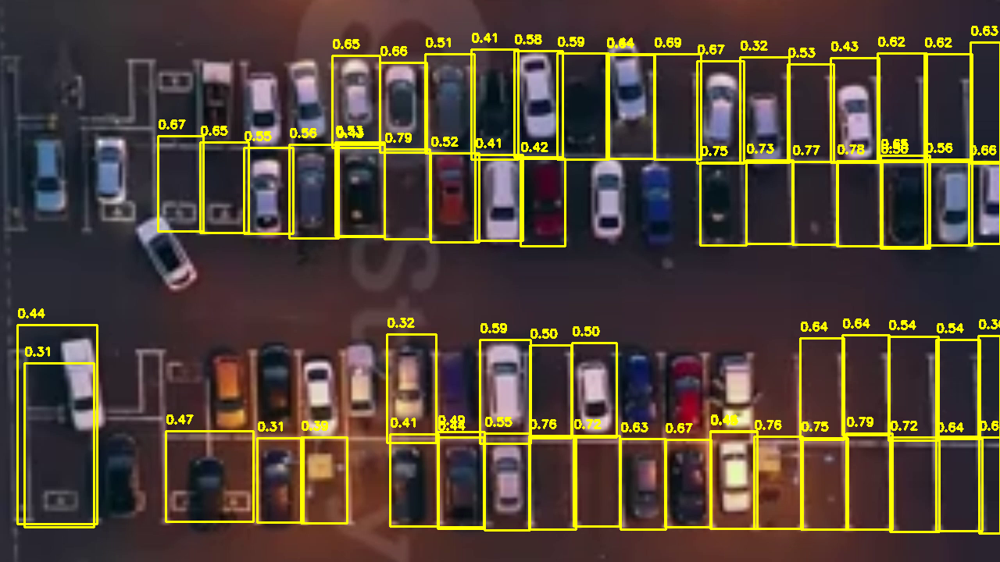


0: 384x640 40 space-emptys, 25 space-occupieds, 29.4ms
Speed: 2.3ms preprocess, 29.4ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


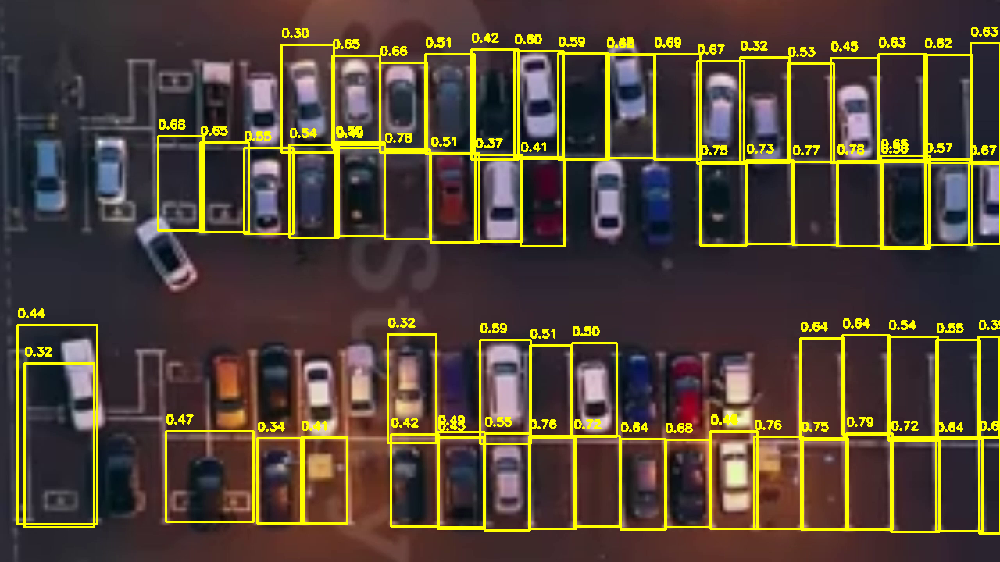


0: 384x640 40 space-emptys, 26 space-occupieds, 25.2ms
Speed: 2.3ms preprocess, 25.2ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


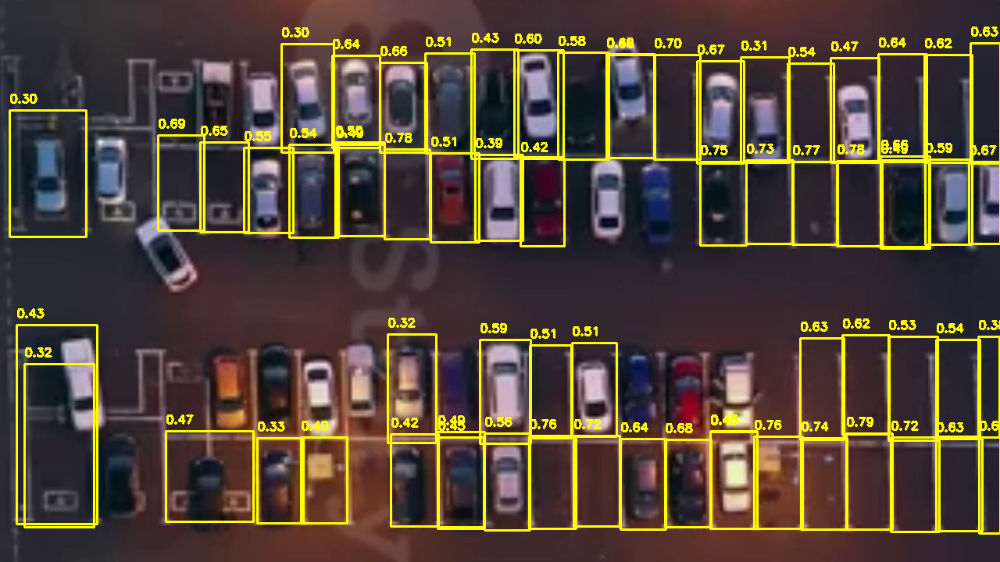


0: 384x640 40 space-emptys, 24 space-occupieds, 25.2ms
Speed: 2.1ms preprocess, 25.2ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


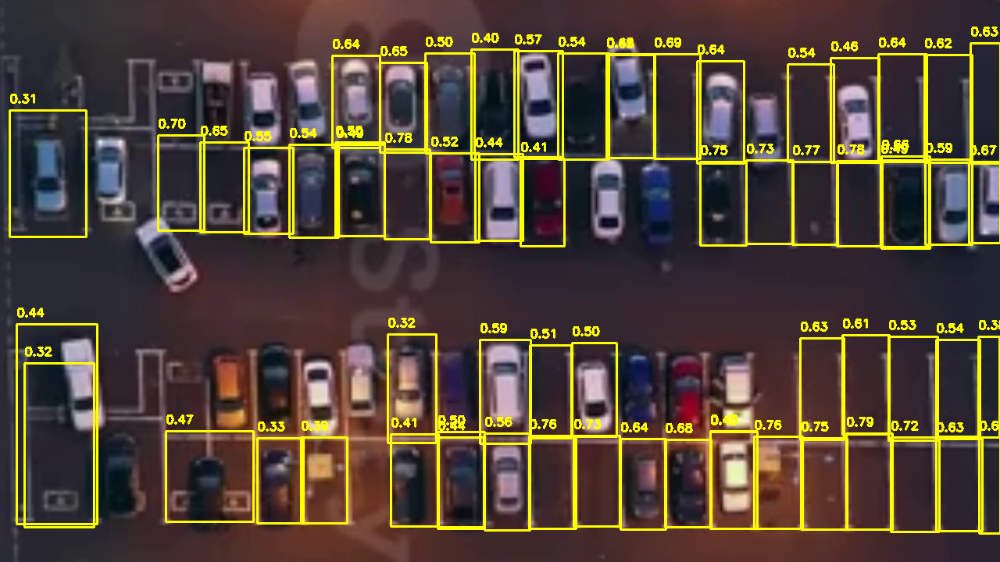


0: 384x640 41 space-emptys, 25 space-occupieds, 25.3ms
Speed: 2.4ms preprocess, 25.3ms inference, 3.1ms postprocess per image at shape (1, 3, 384, 640)


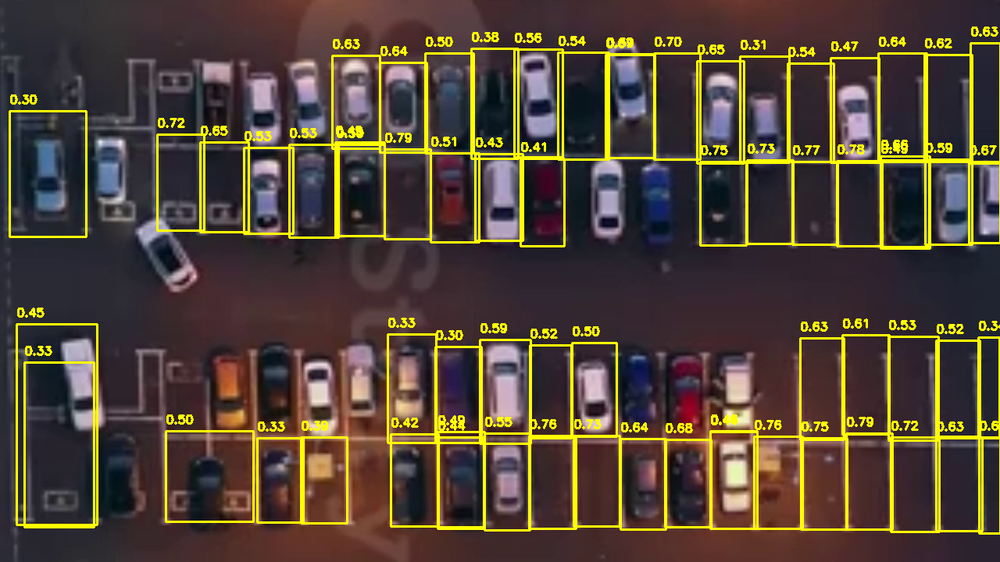


0: 384x640 39 space-emptys, 24 space-occupieds, 25.4ms
Speed: 2.0ms preprocess, 25.4ms inference, 2.8ms postprocess per image at shape (1, 3, 384, 640)


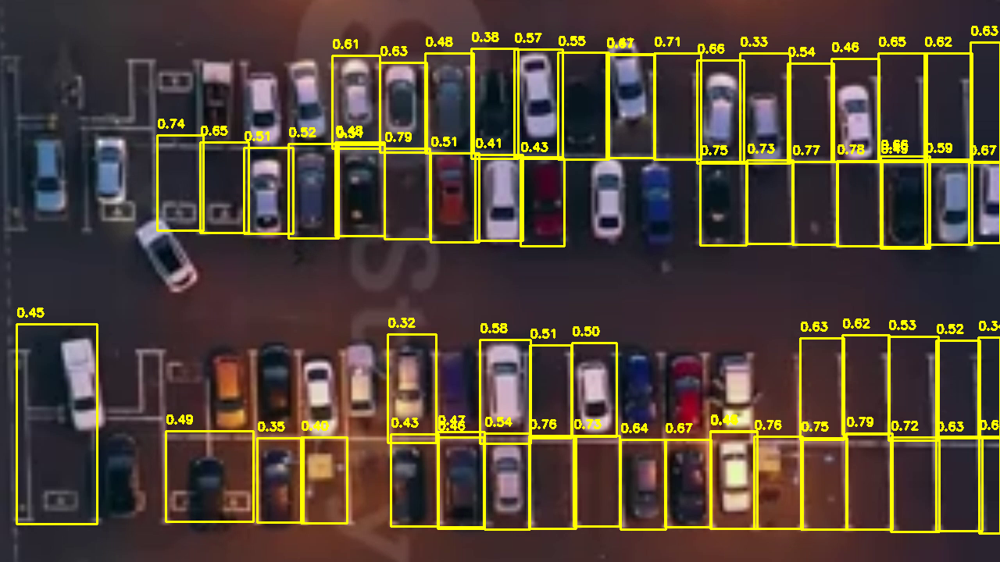


0: 384x640 40 space-emptys, 24 space-occupieds, 25.4ms
Speed: 2.4ms preprocess, 25.4ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


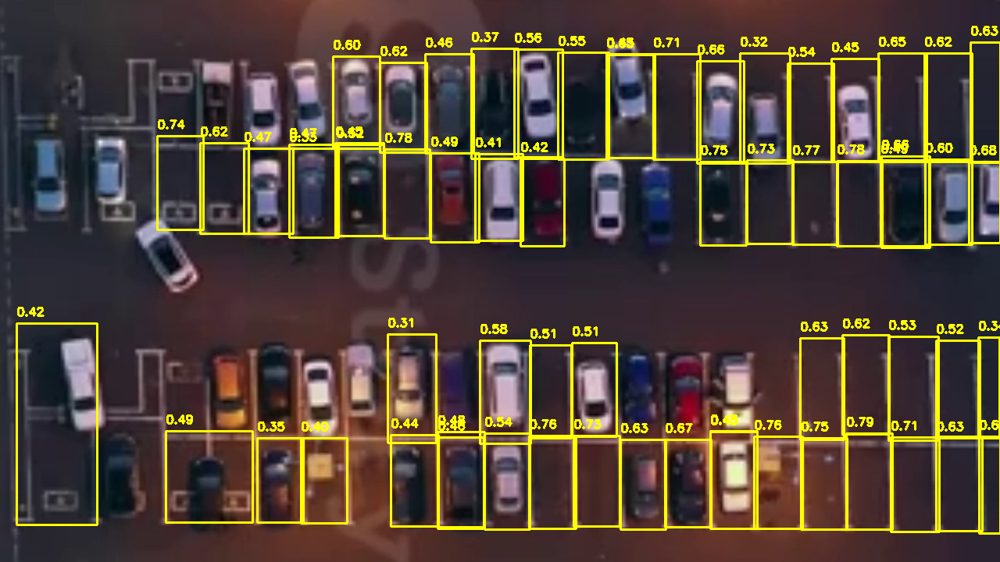


0: 384x640 40 space-emptys, 24 space-occupieds, 25.2ms
Speed: 2.2ms preprocess, 25.2ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


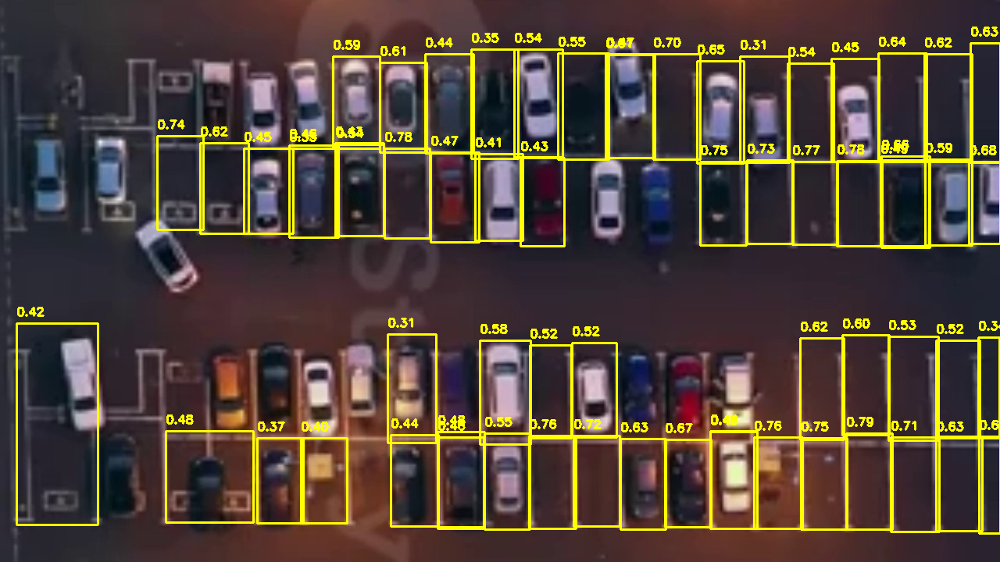


0: 384x640 40 space-emptys, 24 space-occupieds, 25.2ms
Speed: 2.1ms preprocess, 25.2ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


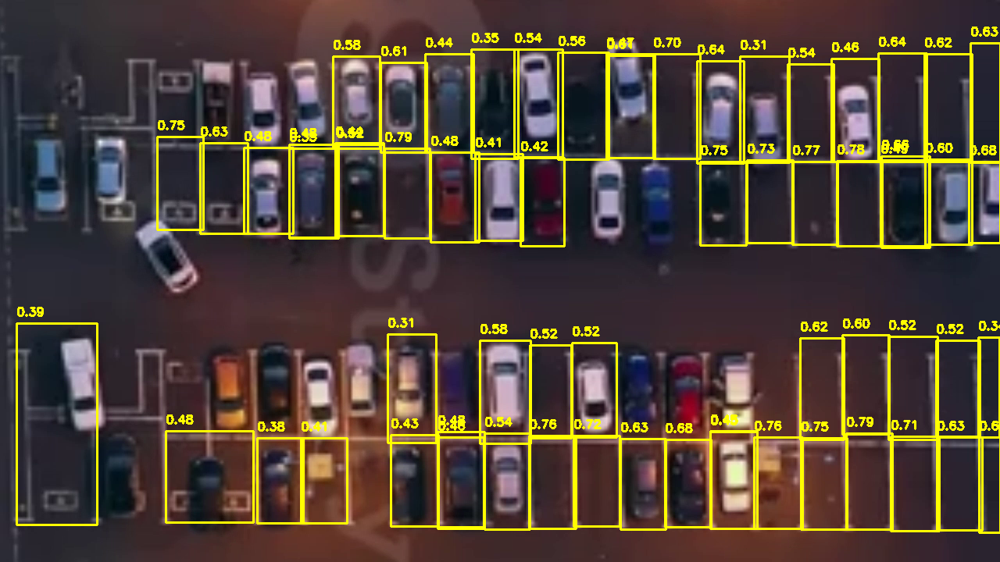


0: 384x640 38 space-emptys, 24 space-occupieds, 25.2ms
Speed: 2.1ms preprocess, 25.2ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


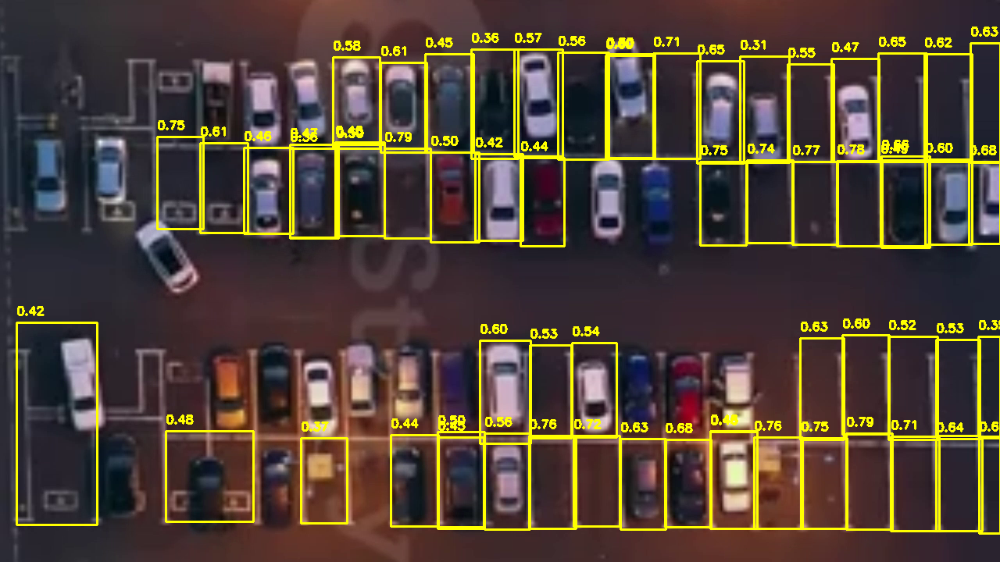


0: 384x640 39 space-emptys, 25 space-occupieds, 25.2ms
Speed: 2.1ms preprocess, 25.2ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


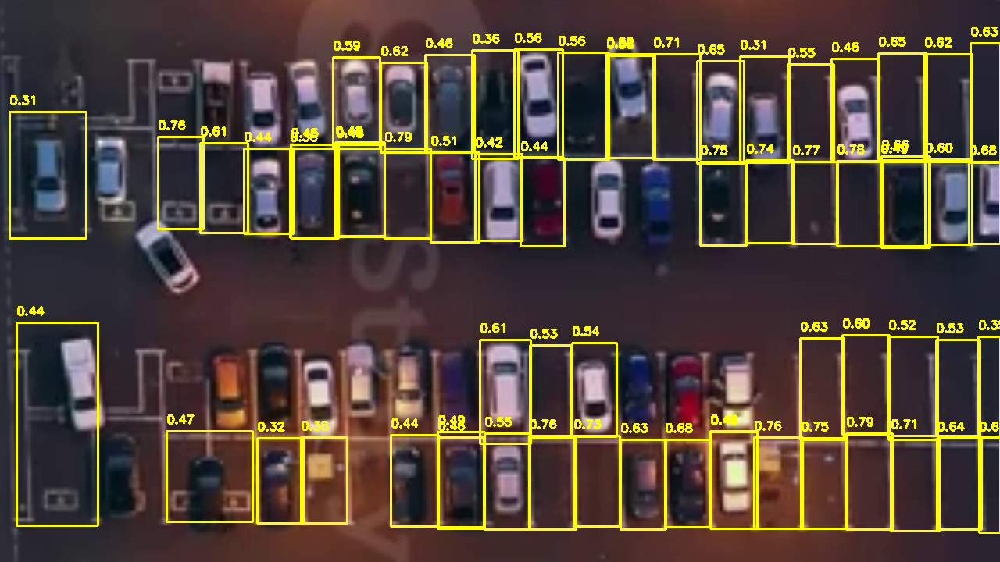


0: 384x640 39 space-emptys, 23 space-occupieds, 25.2ms
Speed: 2.2ms preprocess, 25.2ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


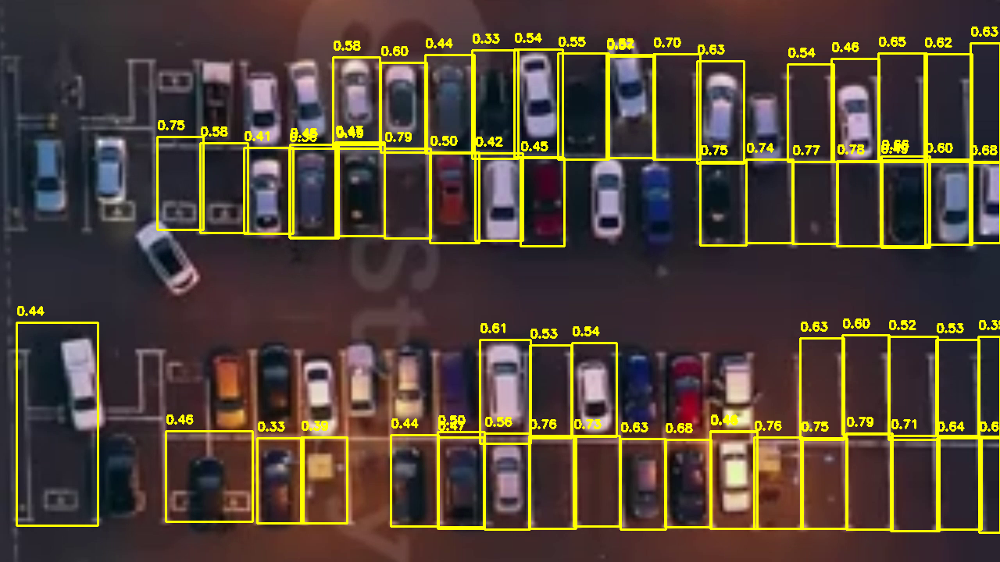


0: 384x640 41 space-emptys, 25 space-occupieds, 25.2ms
Speed: 2.1ms preprocess, 25.2ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


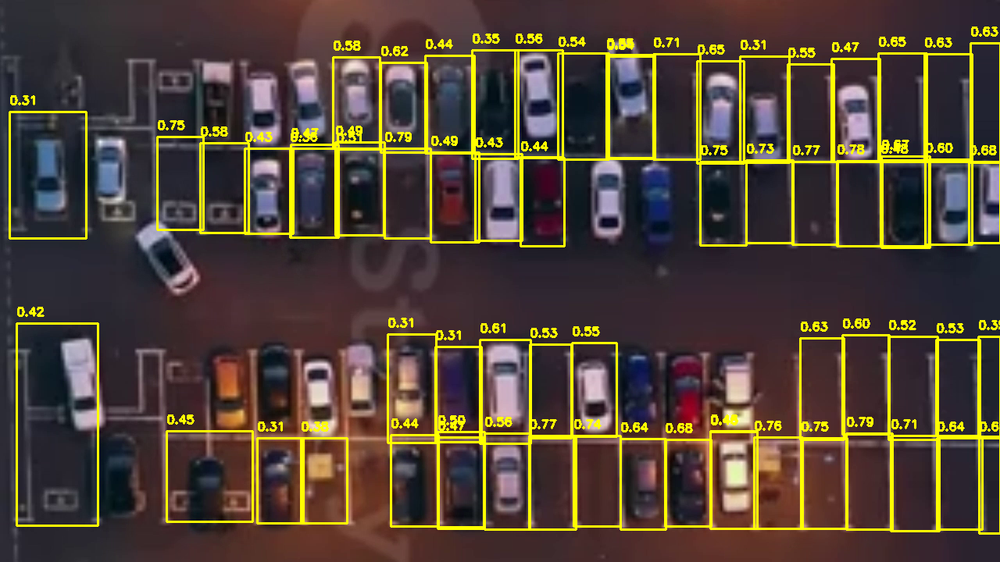


0: 384x640 42 space-emptys, 25 space-occupieds, 25.2ms
Speed: 2.1ms preprocess, 25.2ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


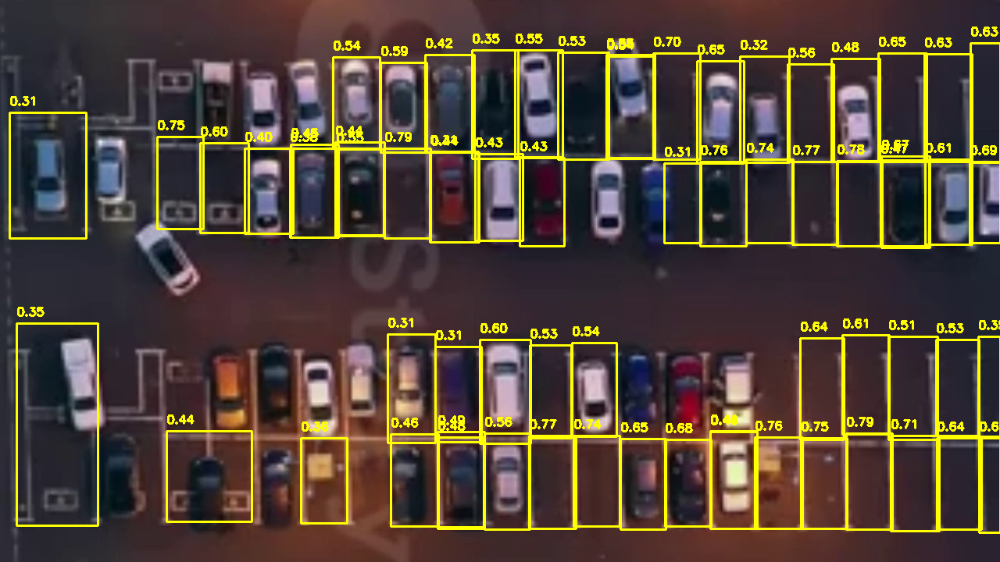


0: 384x640 43 space-emptys, 25 space-occupieds, 25.2ms
Speed: 2.2ms preprocess, 25.2ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


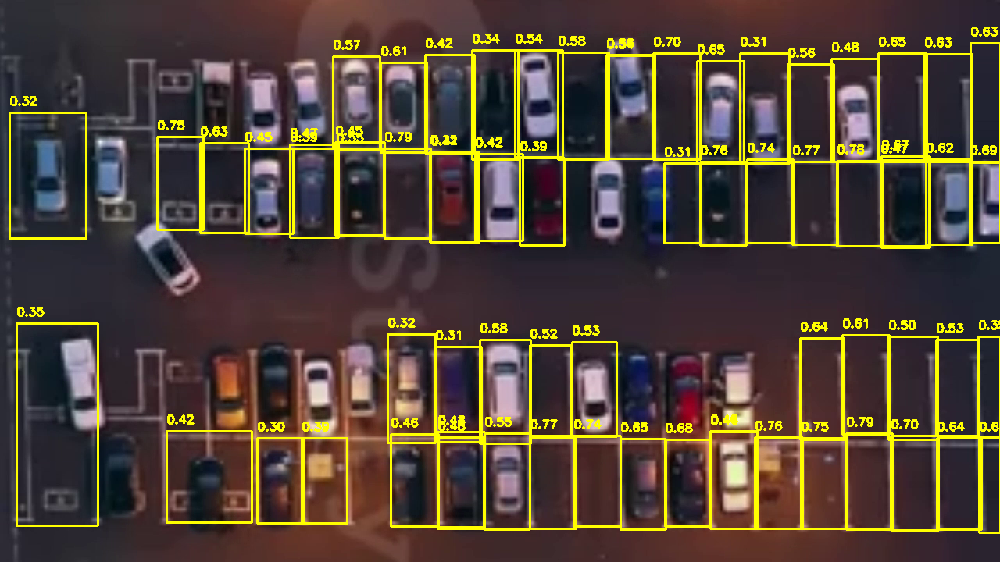


0: 384x640 43 space-emptys, 25 space-occupieds, 25.2ms
Speed: 2.0ms preprocess, 25.2ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


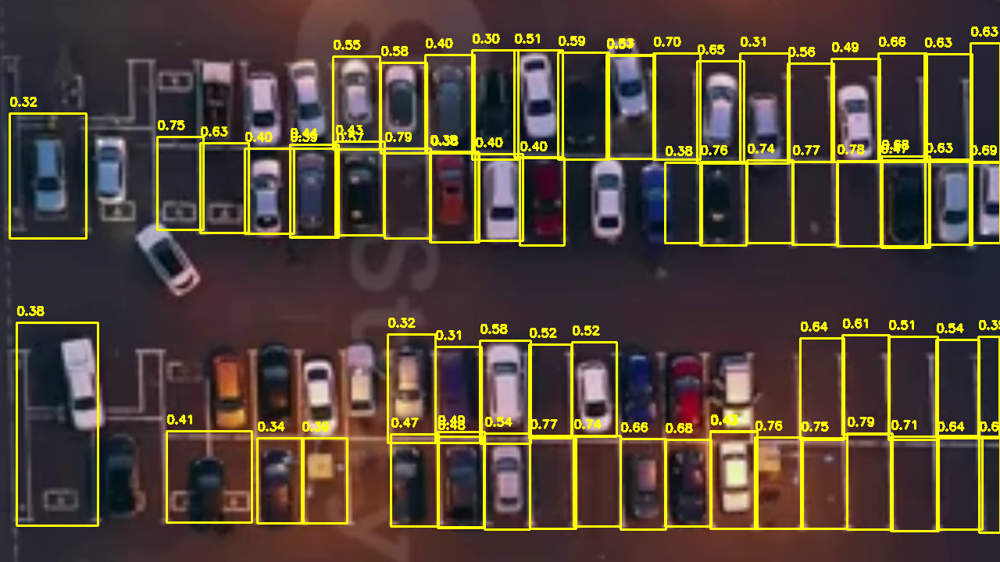


0: 384x640 42 space-emptys, 25 space-occupieds, 26.8ms
Speed: 2.2ms preprocess, 26.8ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)


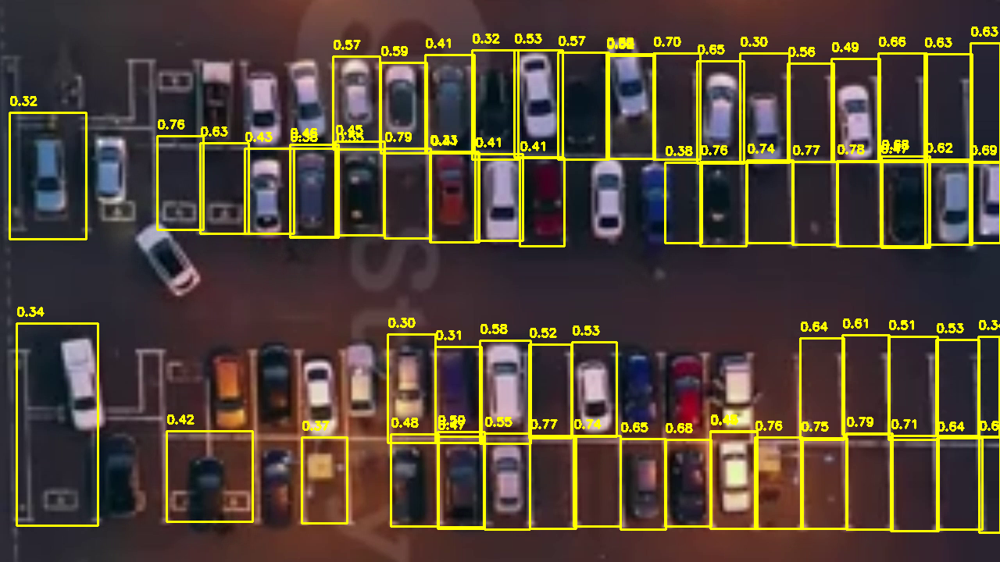


0: 384x640 41 space-emptys, 24 space-occupieds, 25.2ms
Speed: 2.3ms preprocess, 25.2ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


KeyboardInterrupt: 

In [4]:
import cv2
from google.colab.patches import cv2_imshow

# Visualize detection results on a frame
def visualize_detections(frame, results, conf_threshold=0.3):
    vis_frame = frame.copy()
    if results and len(results[0].boxes) > 0:
        boxes = results[0].boxes.xyxy.cpu().numpy()
        confs = results[0].boxes.conf.cpu().numpy()
        for box, conf in zip(boxes, confs):
            if conf < conf_threshold:
                continue
            x1, y1, x2, y2 = map(int, box)
            cv2.rectangle(vis_frame, (x1, y1), (x2, y2), (0, 255, 255), 2)
            cv2.putText(vis_frame, f"{conf:.2f}", (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 255), 2)
    return vis_frame

# Process each frame of the video
def process_video(video_path, model, conf_threshold=0.3):
    cap = cv2.VideoCapture(video_path)

    if not cap.isOpened():
        print(f"Error: Unable to open video file {video_path}")
        return

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        # Call the YOLO model to detect objects in the frame
        results = model(frame, conf=conf_threshold)

        # Visualize the detection on the frame
        detected_frame = visualize_detections(frame, results, conf_threshold)

        # Display the detected frame
        cv2_imshow(detected_frame)

        # Wait for the 'q' key to exit the video playback
        if cv2.waitKey(1) & 0xFF == ord('q'):
            break

    cap.release()
    cv2.destroyAllWindows()

def main():
    model = YOLO('/content/best (1).pt')
    if not model:
        return

    # Path to your video file
    video_path = '/content/Untitled video - Made with Clipchamp (1).mp4'  # Change this to the correct path

    # Process the video and display the results
    process_video(video_path, model)

if __name__ == '__main__':
    main()


**Add SAHI model**

In [1]:
pip install sahi ultralytics

Extracted 10 frames to frames
Performing prediction on 6 slices.


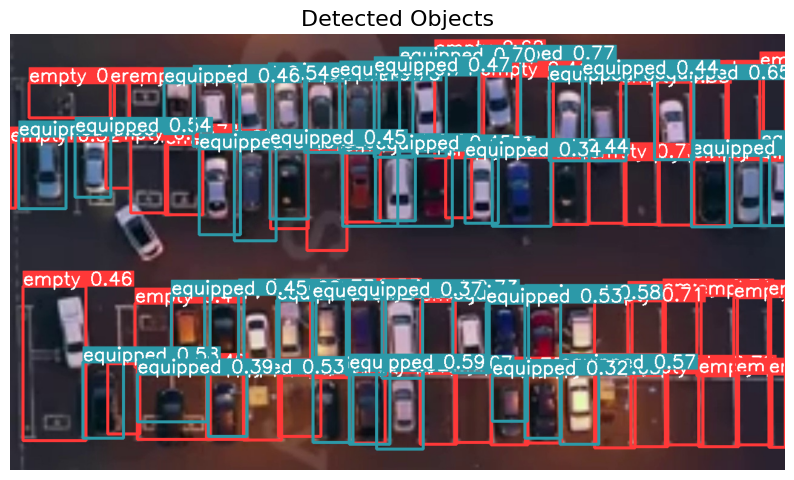

Performing prediction on 6 slices.


KeyboardInterrupt: 

In [5]:

import matplotlib.pyplot as plt
from PIL import Image
from sahi.predict import get_sliced_prediction
from sahi.models.ultralytics import UltralyticsDetectionModel
from google.colab.patches import cv2_imshow
from ultralytics import YOLO

# Define Paths and Model Parameters
yolov8_model_path = '/content/best (1).pt'
category_mapping = {'0': 'empty', '1': 'equipped'}

# Visualize detection results on a frame
def visualize_detections(frame, results, conf_threshold=0.3):
    vis_frame = frame.copy()
    if results and len(results[0].boxes) > 0:
        boxes = results[0].boxes.xyxy.cpu().numpy()
        confs = results[0].boxes.conf.cpu().numpy()
        for box, conf in zip(boxes, confs):
            if conf < conf_threshold:
                continue
            x1, y1, x2, y2 = map(int, box)
            cv2.rectangle(vis_frame, (x1, y1), (x2, y2), (0, 255, 255), 2)
            cv2.putText(vis_frame, f"{conf:.2f}", (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 255), 2)
    return vis_frame

# Extract frames from the video
def extract_frames(video_path, output_dir):
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)
    cap = cv2.VideoCapture(video_path)
    frame_count = 0

    while cap.isOpened() and frame_count < 10:  # Limit to 10 frames
        ret, frame = cap.read()
        if not ret:
            break
        frame_filename = os.path.join(output_dir, f"frame_{frame_count:04d}.jpg")
        cv2.imwrite(frame_filename, frame)
        frame_count += 1
    cap.release()
    print(f"Extracted {frame_count} frames to {output_dir}")
    return [os.path.join(output_dir, f) for f in os.listdir(output_dir) if f.endswith('.jpg')]

# Process each frame for detection using SAHI model
def detect_objects_in_frames_sahi(frames_dir, yolov8_model_path, category_mapping):
    # Initialize SAHI Model
    detection_model = UltralyticsDetectionModel(
        model_path=yolov8_model_path,
        confidence_threshold=0.3,
        category_mapping=category_mapping,
        device="cpu"  # Change to "cuda:0" if using GPU
    )

    # List all frame paths
    frames = [os.path.join(frames_dir, f) for f in os.listdir(frames_dir) if f.endswith('.jpg')]

    for frame_path in frames:
        # Load image
        image = Image.open(frame_path).convert("RGB")

        # Step 1: Perform detection using SAHI
        sliced_prediction = get_sliced_prediction(
            image=image,
            detection_model=detection_model,
            slice_height=640,  # Height of each slice
            slice_width=640,   # Width of each slice
            overlap_height_ratio=0.2,  # Overlap ratio between slices (height)
            overlap_width_ratio=0.2,   # Overlap ratio between slices (width)
        )

        # Step 2: Export visuals (save the output)
        output_dir = "output_dir"
        sliced_prediction.export_visuals(export_dir=output_dir)

        # Step 3: Load the saved image and plot the results
        output_image_path = os.path.join("/content/output_dir/prediction_visual.png")
        output_image = Image.open(output_image_path)

        plt.figure(figsize=(10, 10))
        plt.imshow(output_image)
        plt.axis('off')
        plt.title("Detected Objects", fontsize=16)
        plt.show()

# Process video frames and detect objects using YOLO
def process_video_with_yolo(video_path, model, conf_threshold=0.3):
    cap = cv2.VideoCapture(video_path)

    if not cap.isOpened():
        print(f"Error: Unable to open video file {video_path}")
        return

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        # Call the YOLO model to detect objects in the frame
        results = model(frame)  # Directly pass the frame to the model for detection

        # Visualize the detection on the frame
        detected_frame = visualize_detections(frame, results, conf_threshold)

        # Display the detected frame
        cv2_imshow(detected_frame)

        # Wait for the 'q' key to exit the video playback
        if cv2.waitKey(1) & 0xFF == ord('q'):
            break

    cap.release()
    cv2.destroyAllWindows()

def main():
    video_path = "/content/Untitled video - Made with Clipchamp (1).mp4"  # Path to your video file
    frames_dir = "frames"          # Directory to save frames

    # Step 1: Extract frames from the video
    extract_frames(video_path, frames_dir)

    # Step 2: Run object detection on the extracted frames using SAHI
    detect_objects_in_frames_sahi(frames_dir, yolov8_model_path, category_mapping)

    # Step 3: Run YOLO object detection directly on the video
    model = YOLO('/content/best (1).pt')
    if not model:
        return

    # Process the video and display the results
    process_video_with_yolo(video_path, model)

if __name__ == "__main__":
    main()